# Team 4: Machine Predictive Maintenance Classification

Contributors: Elan Wilkinson, Zack Robertson, Alden Caterio, Laxmi Sulakshana Rapolu

## Problem Statement

The primary objective of this project is to create a predictive model capable of precisely predicting the probability and nature of potential future machine failures. Utilizing an extensive Predictive Maintenance Dataset that encompasses temperature metrics, machine measurement readings, variations in product quality, states of failure, and types of failure, this model aims to facilitate preemptive maintenance approaches. These strategies could not only prolong the equipment's operational life but also offer considerable financial benefits to consumers.

## Justification
This initiative is driven by the urgent need within the industry to improve machinery reliability and longevity. By understanding and predicting potential failures, we can not only design more robust equipment but also develop proactive maintenance strategies.

Through precise failure forecasts, predictive maintenance can notably prolong equipment longevity, offering significant financial and resource savings. It also promises heightened product standards, minimized operational interruptions, and increased efficiency.

Our investigation will delve into various modeling techniques, focusing on the power of ensemble methods to bolster prediction accuracy by merging multiple model advantages. Assessing these methods side by side will shed light on the most efficacious predictive maintenance strategies.

Ultimately, the success of this project could transform maintenance practices in machinery production, steering towards more durable, efficient, and economical operations.

## Dataset
The AI4I 2020 Predictive Maintenance Dataset encompasses 10,000 data points, each with 14 distinct features. These features include a unique identifier (UID), product ID with quality variants (L, M, H), air temperature [K], process temperature [K], rotational speed [rpm], torque [Nm], tool wear [min], and a ‘machine failure’ label indicating the occurrence of a failure. The dataset ingeniously simulates five independent failure modes: tool wear failure (TWF), heat dissipation failure (HDF), power failure (PWF), overstrain failure (OSF), and random failures (RNF). Each mode is defined by specific conditions, such as the relationship between torque and rotational speed or the product of tool wear and torque.

Dataset URL: https://www.kaggle.com/datasets/shivamb/machine-predictive-maintenance-classification <br/>
Acknowledgements: https://archive.ics.uci.edu/dataset/601/ai4i+2020+predictive+maintenance+dataset

## Packages

In [1]:
!pip install ucimlrepo pandas numpy matplotlib seaborn dataprep scikit-learn tensorflow imblearn xgboost

In [136]:
# Import required libraries
from ucimlrepo import fetch_ucirepo
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from sklearn.preprocessing import LabelEncoder, StandardScaler
from dataprep.eda import plot, plot_correlation, plot_missing, plot_diff, create_report
from dataprep.clean import *
from sklearn import preprocessing
from imblearn.over_sampling import RandomOverSampler
from sklearn import tree
from sklearn.model_selection import train_test_split,  RandomizedSearchCV, GridSearchCV
from sklearn import metrics
from scipy.stats import randint
from xgboost import XGBClassifier, plot_importance
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.svm import LinearSVC

In [4]:
# Clean up warnings and loggings
import warnings
warnings.filterwarnings("ignore")
import logging
logging.getLogger().setLevel(logging.INFO)

## Load Dataset

A synthetic dataset that reflects real predictive maintenance data encountered in industry, it consists of 10,000 data points stored as rows with 6 features in columns.

**Feature Variables**:
- Type : The product quality is categorized using the letters L, M, and H to represent low (50% of all products), medium (30%), and high (20%) quality variants, respectively. This system simplifies the classification of product standards across the range.
- air temperature [K] : The data was produced through a random walk process and subsequently adjusted to have a standard deviation of 2 Kelvin, centered around a mean temperature of 300 Kelvin.
- process temperature [K] : The process involves a random walk method, adjusted to a standard deviation of one Kelvin. This is then applied to the ambient air temperature, which has been increased by ten Kelvins.
- rotational speed [rpm] : The calculation was based on a power output of 2860 watts, with the addition of noise that follows a normal distribution.
- torque [Nm] : The distribution of torque values is centered around 40 Nm, with a standard deviation of 10 Nm, ensuring that all values remain positive. This normal distribution indicates that while the majority of the torque values are close to the mean, there is a variation that is accounted for by the standard deviation, with no values falling below zero.
- tool wear [min] : The quality variants labeled as High (H), Medium (M), and Low (L) contribute an additional 5, 3, and 2 minutes, respectively, to the wear of the tool used in the process.

**Target Variables**:
- Machine failure : This signifies whether the machine has experienced a failure at this specific data point.

The machine's failure can be attributed to five distinct failure modes. 
1. tool wear failure (TWF) : occurs when a tool must be replaced after a randomly determined wear period of 200 to 240 minutes. 
2. heat dissipation failure (HDF) : happens when the temperature difference between the air and the process falls below 8.6 K, with the tool's rotational speed under 1380 rpm. 
3. power failure (PWF) : happens when the calculated power, from torque and rotational speed, falls outside the 3500 W to 9000 W range. 
4. overstrain failure (OSF) : identified when the combination of tool wear and torque surpasses a certain threshold, which varied for different product variants. 
5. random failures (RNF) : represent a 0.1% chance of failure regardless of process parameters.

In [5]:
# Read data from 'predictive_maintenance.csv' file downloaded from kaggle 
df = pd.read_csv('predictive_maintenance.csv')

In [7]:
# Dataset first 5 rows
print('Final dataset: \r\n', df.head(), '\r\n')

# Machine failure dataset first 5 rows
print('Machine failure dataset: \r\n', df[df['Target'] != 0].head())

Final dataset: 
    UDI Product ID Type  Air temperature [K]  Process temperature [K]  \
0    1     M14860    M                298.1                    308.6   
1    2     L47181    L                298.2                    308.7   
2    3     L47182    L                298.1                    308.5   
3    4     L47183    L                298.2                    308.6   
4    5     L47184    L                298.2                    308.7   

   Rotational speed [rpm]  Torque [Nm]  Tool wear [min]  Target Failure Type  
0                    1551         42.8                0       0   No Failure  
1                    1408         46.3                3       0   No Failure  
2                    1498         49.4                5       0   No Failure  
3                    1433         39.5                7       0   No Failure  
4                    1408         40.0                9       0   No Failure   

Machine failure dataset: 
      UDI Product ID Type  Air temperature [K]  

## Data Cleaning

Data cleaning is an essential process in preparing data for machine learning. It involves the elimination of missing values, duplicates, and irrelevant information to enhance data quality to improve model performance and for reliable predictions.

- **Handle Missing Data**: It is a critical step in data analysis, which ensures the quality and integrity of the results. Imputation (replace missing values with a statistical estimate) and dropping rows or columns with missing values are the methods implemented depending on the nature of the data. For this dataset found **no missing values**.
- **Deduplicate Data**: Duplicate entries in a dataset can lead to inaccurate models because they overrepresent certain information, potentially biasing the model's performance. For this dataset found **no duplicate values**. 
- **Remove Irrelavant Data**: For this dataset removing rows where ‘Target’ is not 0 and ‘Failure Type’ is ‘No Failure’, since ‘Target’ is not 0 (indicating some kind of failure), then ‘Failure Type’ should not be ‘No Failure’. **Found 9 rows with irrelavant data**.
- **Dropping Unnecessary columns**: In the context of a multi-class classification task aimed at predicting various failure types, including 'No Failure', the 'Failure Type' column is essential as it acts as the target variable. The 'Target' column becomes redundant since its data is already represented within the 'Failure Type' column. Additionally, columns like 'UID' and 'Product ID', which are unique identifiers, do not contribute to the predictive model's performance and can be considered for removal to streamline the dataset. So **removing 'UDI', 'Product Id', 'Target' column**.

In [15]:
# Check for rows with missing values
print('Number of rows with missing values: ', df.isnull().any(axis=1).sum(), '\r\n')

# Check for duplicate rows
print('Number of duplicate rows: ', df.duplicated().sum())

Number of rows with missing values:  0 

Number of duplicate rows:  0


In [17]:
# Check for discrepancy or error in the data 
print(df[(df['Target'] != 0) & (df['Failure Type'] == 'No Failure')])

       UDI Product ID Type  Air temperature [K]  Process temperature [K]  \
1437  1438     H30851    H                298.8                    309.9   
2749  2750     M17609    M                299.7                    309.2   
4044  4045     M18904    M                301.9                    310.9   
4684  4685     M19544    M                303.6                    311.8   
5536  5537     M20396    M                302.3                    311.8   
5941  5942     L53121    L                300.6                    310.7   
6478  6479     L53658    L                300.5                    309.8   
8506  8507     L55686    L                298.4                    309.6   
9015  9016     L56195    L                297.2                    308.1   

      Rotational speed [rpm]  Torque [Nm]  Tool wear [min]  Target  \
1437                    1439         45.2               40       1   
2749                    1685         28.9              179       1   
4044                    1419 

In [18]:
# Remove rows with discrepancy or error in the data 
df = df[~((df['Target'] != 0) & (df['Failure Type'] == 'No Failure'))]

In [23]:
# Drop unnecessary columns
df_final = df.drop(['UDI', 'Product ID', 'Target'], axis=1)

# Print final dataset with out unnecessary columns
print("Final dataset with out unnecessary columns: \r\n", df_final.head())

Final dataset with out unnecessary columns: 
   Type  Air temperature [K]  Process temperature [K]  Rotational speed [rpm]  \
0    M                298.1                    308.6                    1551   
1    L                298.2                    308.7                    1408   
2    L                298.1                    308.5                    1498   
3    L                298.2                    308.6                    1433   
4    L                298.2                    308.7                    1408   

   Torque [Nm]  Tool wear [min] Failure Type  
0         42.8                0   No Failure  
1         46.3                3   No Failure  
2         49.4                5   No Failure  
3         39.5                7   No Failure  
4         40.0                9   No Failure  


## Exploratory Data Analysis

### Descriptive Data Analysis

The dataset consists of **9991 entries** and **7 columns**. The columns in the dataset are as follows:

1. **Type**: This is a categorical variable with three unique values (L, M, H). The most frequent category is 'L' with 5996 occurrences.
2. **Air temperature [K]**: This is a continuous variable with a mean value of approximately 300.00 K. The minimum and maximum values are 295.30 K and 304.50 K, respectively.
3. **Process temperature [K]**: This is a continuous variable with a mean value of approximately 310.00 K. The minimum and maximum values are 305.70 K and 313.80 K, respectively.
4. **Rotational speed [rpm]**: This is an integer variable with a mean value of approximately 1538.80 rpm. The minimum and maximum values are 1168 rpm and 2886 rpm, respectively.
5. **Torque [Nm]**: This is a continuous variable with a mean value of approximately 39.99 Nm. The minimum and maximum values are 3.80 Nm and 76.60 Nm, respectively.
6. **Tool wear [min]**: This is an integer variable with a mean value of approximately 107.94 minutes. The minimum and maximum values are 0 minutes and 253 minutes, respectively.
7. **Failure Type**: This is a categorical variable with six unique values. The most frequent category is 'No Failure' with 9643 occurrences. The other categories include 'Heat Dissipation Failure', 'Power Failure', 'Overstrain Failure', 'Tool Wear Failure', and 'Random Failures'.

In [24]:
# Overview of Dataframe
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9991 entries, 0 to 9999
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Type                     9991 non-null   object 
 1   Air temperature [K]      9991 non-null   float64
 2   Process temperature [K]  9991 non-null   float64
 3   Rotational speed [rpm]   9991 non-null   int64  
 4   Torque [Nm]              9991 non-null   float64
 5   Tool wear [min]          9991 non-null   int64  
 6   Failure Type             9991 non-null   object 
dtypes: float64(3), int64(2), object(2)
memory usage: 624.4+ KB


In [25]:
# Descriptive statistics including all data types
print(df_final.describe(include='all'))

        Type  Air temperature [K]  Process temperature [K]  \
count   9991          9991.000000              9991.000000   
unique     3                  NaN                      NaN   
top        L                  NaN                      NaN   
freq    5996                  NaN                      NaN   
mean     NaN           300.004634               310.005385   
std      NaN             2.000300                 1.483990   
min      NaN           295.300000               305.700000   
25%      NaN           298.300000               308.800000   
50%      NaN           300.100000               310.100000   
75%      NaN           301.500000               311.100000   
max      NaN           304.500000               313.800000   

        Rotational speed [rpm]  Torque [Nm]  Tool wear [min] Failure Type  
count              9991.000000  9991.000000      9991.000000         9991  
unique                     NaN          NaN              NaN            6  
top                        

In [26]:
# Get value counts for object columns
for col in df_final.select_dtypes(include=['object']).columns:
    print(f"Column: {col}")
    print(df_final[col].value_counts())
    print("\r\n")

Column: Type
L    5996
M    2993
H    1002
Name: Type, dtype: int64


Column: Failure Type
No Failure                  9643
Heat Dissipation Failure     112
Power Failure                 95
Overstrain Failure            78
Tool Wear Failure             45
Random Failures               18
Name: Failure Type, dtype: int64




### Exploratory Plots
 Exploratory plots are graphical representations used to understand the basic properties of the data, find simple patterns, and suggest possible modeling strategies.<br/>
 For more DataPre plots: https://drive.google.com/file/d/1jElr4sZIm3aAqf8Hgg21hoBBeBD2AQKp/view?usp=sharing 

#### Univariant Analysis

KDE Plot for Numeric Variables:
- **air temperature [K]** : The KDE plot reveals a symmetrical data distribution around the most frequent temperatures, slightly below and above 300 K. The presence of peaks indicates these are the most common temperatures, while the diminishing tails suggest that extreme temperatures are rare. This pattern implies the machinery typically operates within a stable temperature range, centered around the mean.
- **process temperature [K]** : The KDE plot for process temperature in Kelvin shows a distribution with two prominent peaks, indicating that there are two temperatures at which processes occur more frequently. The highest peak just above 310 K suggests this is the most common process temperature within the dataset.
- **rotational speed [rpm]** : The KDE plot analysis indicates that the most frequent rotational speed for the machinery is approximately 1500 rpm. The right-skewed distribution suggests a prevalence of higher speeds beyond this mode, implying that the machinery is commonly run at or above 1500 rpm. This pattern may point to this speed range being the most efficient or productive for the machinery's operation.
- **torque [Nm]** : The KDE plot illustrates a normal distribution of torque measurements, highlighting a central tendency at 40 Nm, which is the most frequently observed value. The data points are spread across a range from 0 to 80 Nm, with a concentration near the middle, signifying a consistent and reliable set of measurements. 
- **tool wear [min]** : The KDE Plot indicates that tools are most prone to wear within the first 10-20 minutes of operation, necessitating regular maintenance. The data suggests tools have a reduced lifespan, with wear occurring more frequently at the beginning of usage.

Bar chart for Categorical variables:
- **Type** : The bar chart reveals a distinct hierarchy among the categories, with 'L' leading significantly at 6000, 'M' at a moderate 3000, and 'H' trailing at 1000. This disparity highlights 'L' as potentially the most influential category, while 'M' and 'H' hold lesser weight. 
- **Failure Type** : The bar chart reveals a significant predominance of the 'No failure' category, dwarfing the instances of specific failures such as Heat-Dispersion, Power, Overstrain, Tool Wear, and Random Failures. This disparity suggests that the system or process under study exhibits a high degree of operational reliability, likely due to effective preventive maintenance strategies.


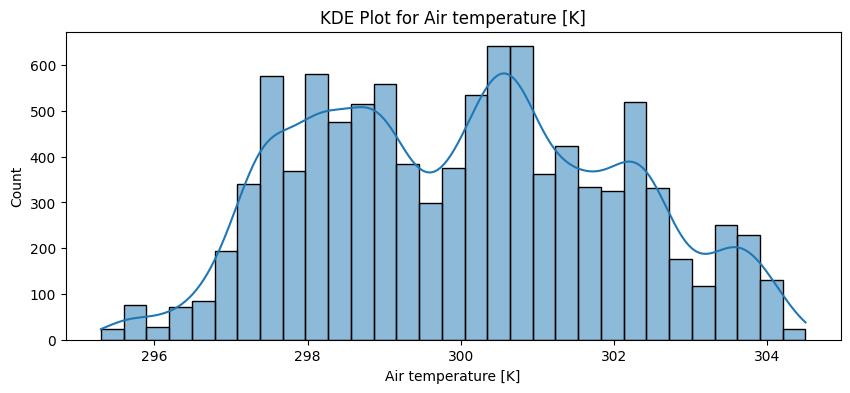

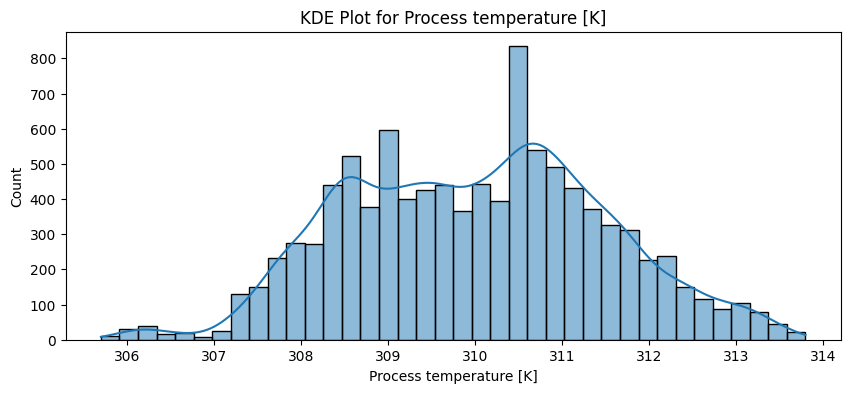

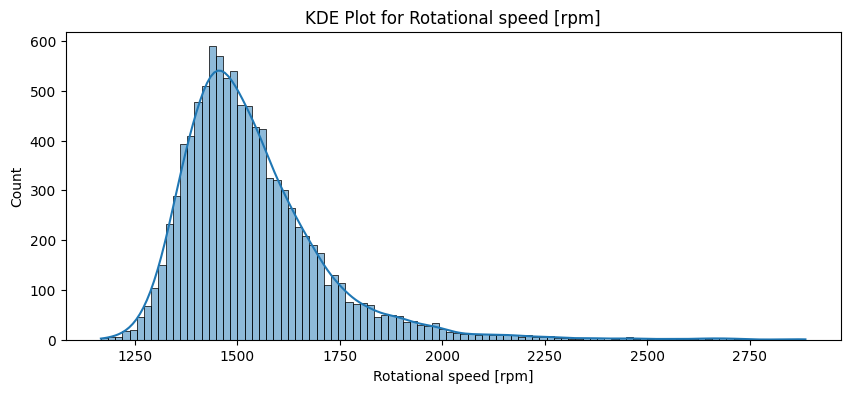

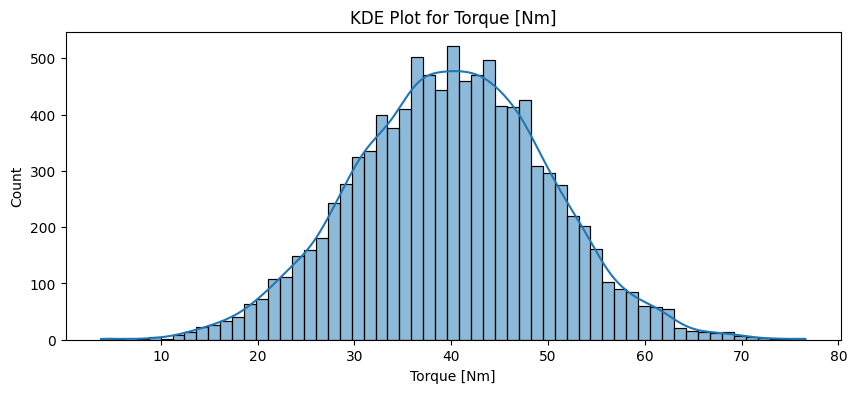

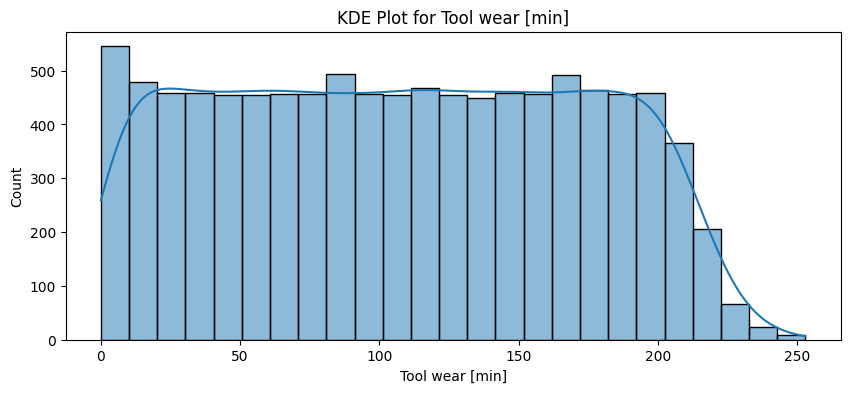

In [40]:
# KDE plots for numeric columns
numeric_cols = df_final.select_dtypes(include=['int64', 'float64']).columns
for col in numeric_cols:
    plt.figure(figsize=(10, 4))
    sns.histplot(data=df_final, x=col, kde=True)
    plt.title(f'KDE Plot for {col}')
    plt.show()

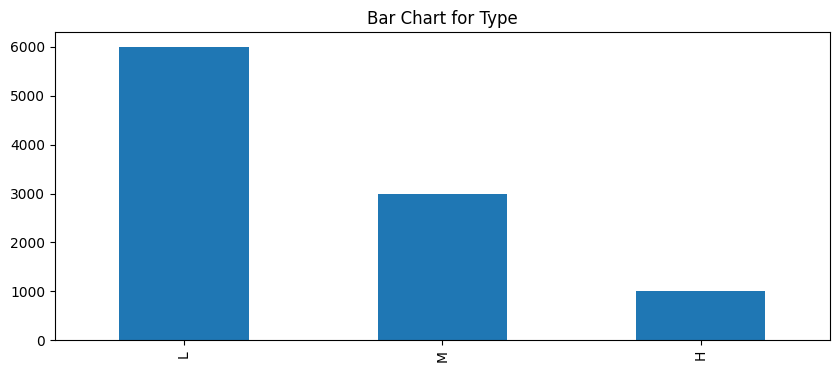

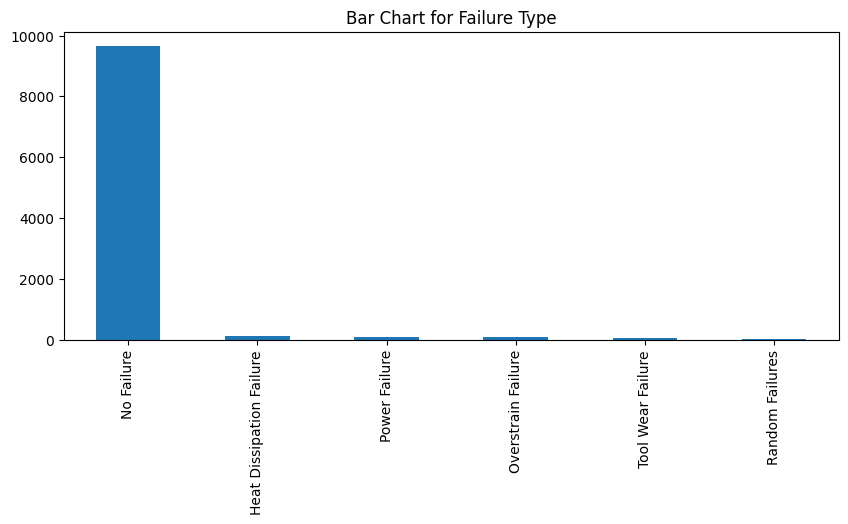

In [41]:
# Bar charts for categorical columns
object_cols = df_final.select_dtypes(include=['object']).columns
for col in object_cols:
    plt.figure(figsize=(10, 4))
    df_final[col].value_counts().plot(kind='bar')
    plt.title(f'Bar Chart for {col}')
    plt.show()

#### Bivariant Analysis
- **Air temperature [K] vs Process temperature [K]** : The lineplot analysis indicates a direct and consistent relationship between air and process temperatures. Air temperature exhibits more variability with a higher standard deviation, while process temperature maintains a steady increment of 10 Kelvins above the air temperature. This predictable pattern, marked by a lower standard deviation in process temperature, is essential for effective temperature regulation in industrial processes, ensuring stability and efficiency in operations.
- **Rotational speed [rpm] vs Torque [Nm]** : The lineplot analysis reveals a clear inverse relationship between rotational speed and torque, with higher speeds resulting in lower torque. This information is crucial for designing mechanical systems with precise torque and speed requirements.
- **Type vs Tool wear [min]** : The lineplot analysis indicates that tool wear time increases with the quality of the product, the high-quality products, although fewer in number (20%), have a significant impact on tool wear. This insight is crucial for planning maintenance and tool replacement to maintain production efficiency.
- **Type vs Failure Type** : The analysis of the stacked bar chart indicates that Category L has the most significant number of failures, highlighting an urgent need for enhancements in reliability. It's essential to delve into the distinct failure patterns across the categories to devise targeted strategies for mitigating failures, which will contribute to a reduction in the overall failure rates. This tailored approach is crucial for improving performance and achieving operational excellence.


Plot "Air temperature [K]" vs "Process temperature [K]": 


<AxesSubplot:xlabel='Air temperature [K]', ylabel='Process temperature [K]'>

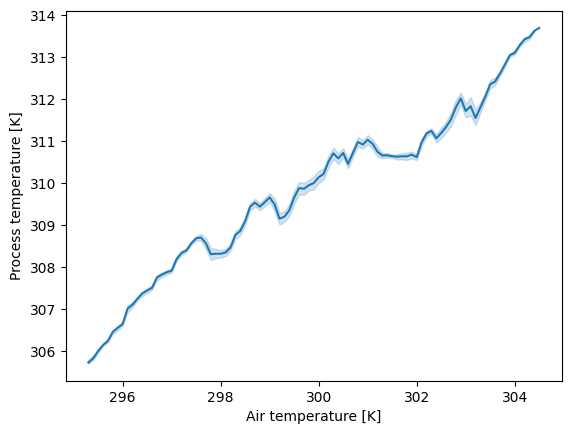

In [68]:
# Plot 'Air temperature [K]' vs 'Process temperature [K]'
print('Plot "Air temperature [K]" vs "Process temperature [K]": ')
sns.lineplot(data=df_final, x='Air temperature [K]', y='Process temperature [K]')

Plot "Rotational speed [rpm]" vs "Torque [Nm]": 


<AxesSubplot:xlabel='Rotational speed [rpm]', ylabel='Torque [Nm]'>

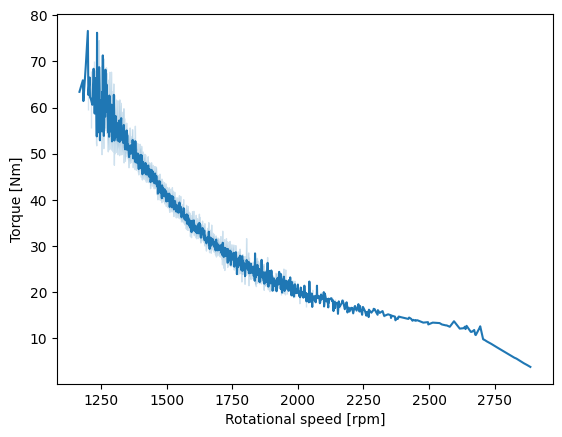

In [69]:
# Plot 'Rotational speed [rpm]' vs 'Torque [Nm]'
print('Plot "Rotational speed [rpm]" vs "Torque [Nm]": ')
sns.lineplot(data=df_final, x='Rotational speed [rpm]', y='Torque [Nm]')

Plot "Type" vs "Tool wear [min]": 


<AxesSubplot:xlabel='Type', ylabel='Tool wear [min]'>

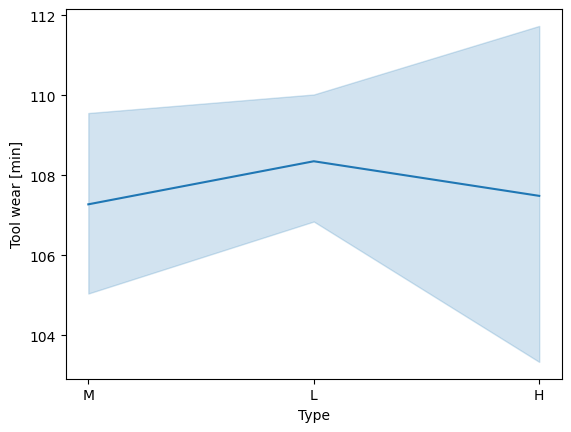

In [70]:
# Plot 'Type' vs 'Tool wear [min]'
print('Plot "Type" vs "Tool wear [min]": ')
sns.lineplot(data=df_final, x='Type', y='Tool wear [min]')

Plot "Type" vs "Failure Type" for data with out machine failure: 


<AxesSubplot:xlabel='Type', ylabel='Count'>

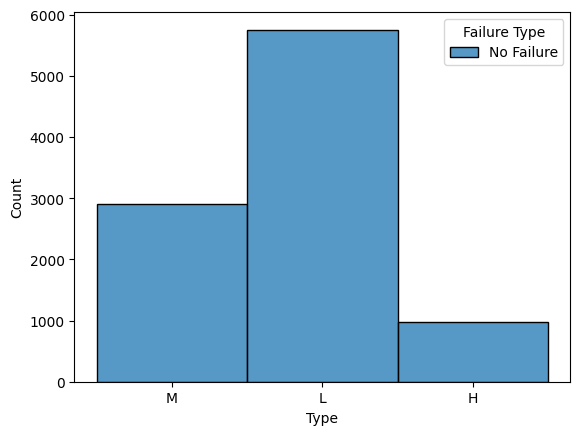

In [71]:
# Plot 'Type' vs 'Failure Type' for data with out machine failure
print('Plot "Type" vs "Failure Type" for data with out machine failure: ')
sns.histplot(data=df_final[df_final['Failure Type'] == 'No Failure'], x='Type', hue='Failure Type', multiple='stack')

Plot "Type" vs "Failure Type" for data with machine failure: 


<AxesSubplot:xlabel='Type', ylabel='Count'>

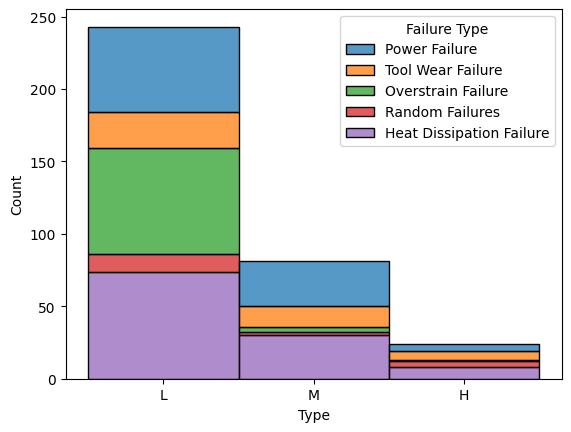

In [72]:
# Plot 'Type' vs 'Failure Type' for data with machine failure
print('Plot "Type" vs "Failure Type" for data with machine failure: ')
sns.histplot(data=df_final[df_final['Failure Type'] != 'No Failure'], x='Type', hue='Failure Type', multiple='stack')

#### Multivariant Analysis

The pair plot analysis is a key step in exploratory data analysis. It provides insights into the dataset by revealing the distribution of variables like "Air temperature [K]" and "Process temperature [K]". It also highlights potential correlations between variables. The analysis identifies outliers and data quality issues such as gaps or irregularities, emphasizing the need for careful data handling and further statistical validation.

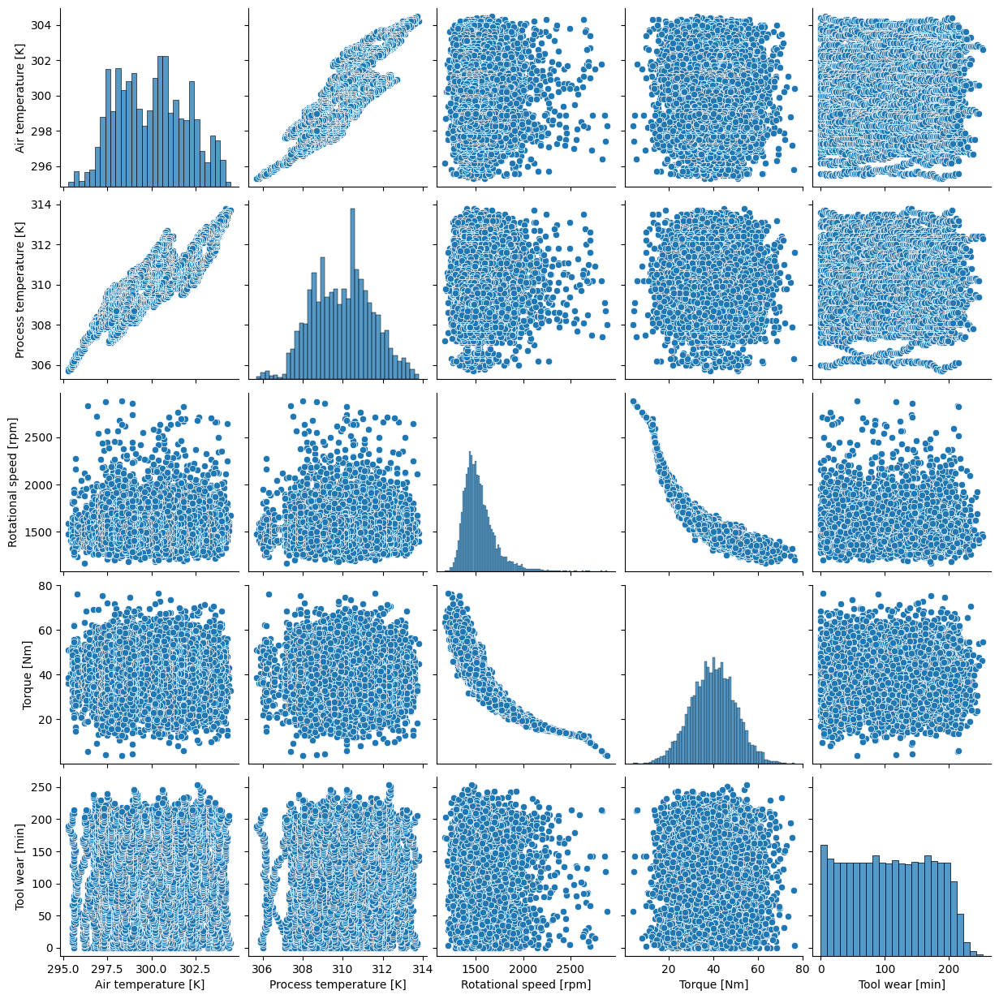

In [73]:
# Pair plot for entire dataframe
sns.pairplot(df_final)

#### Compare Dataframes (Based on Machine Failure)
There are significantly fewer data points with machine failure compared to normal operation, it suggests that machine failures are rare events in the dataset. In datasets where machine failures are infrequent, addressing data imbalance is crucial for effective machine learning. Evaluation metrics beyond accuracy, such as AUC-ROC and F1 score, provide a more nuanced view of model performance. Decision trees and ensemble methods may offer better handling of imbalanced data. 



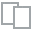
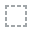
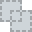
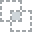
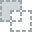
...
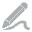
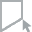
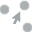
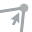
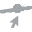

In [74]:
# Comapare dataframes based on machine failure status
df_final_MF0 = df_final[df_final['Failure Type'] == 'No Failure']
df_final_MF1 = df_final[df_final['Failure Type'] != 'No Failure']
plot_diff([df_final_MF0, df_final_MF1])

#### Correlation Plots
The heatmap provides a visual representation of the relationships between variables. Dark red squares signal a strong positive correlation, suggesting that variables (Air temperature [K] and Process temperature [K]) increase together. Conversely, dark blue squares denote a strong negative correlation, indicating an inverse relationship between variables (Rotational speed [rpm] and Torque [Nm]). White or light-colored squares represent weak or no correlation, showing no significant linear relationship. These patterns are crucial for understanding parameter interdependencies, optimizing processes, and planning predictive maintenance.

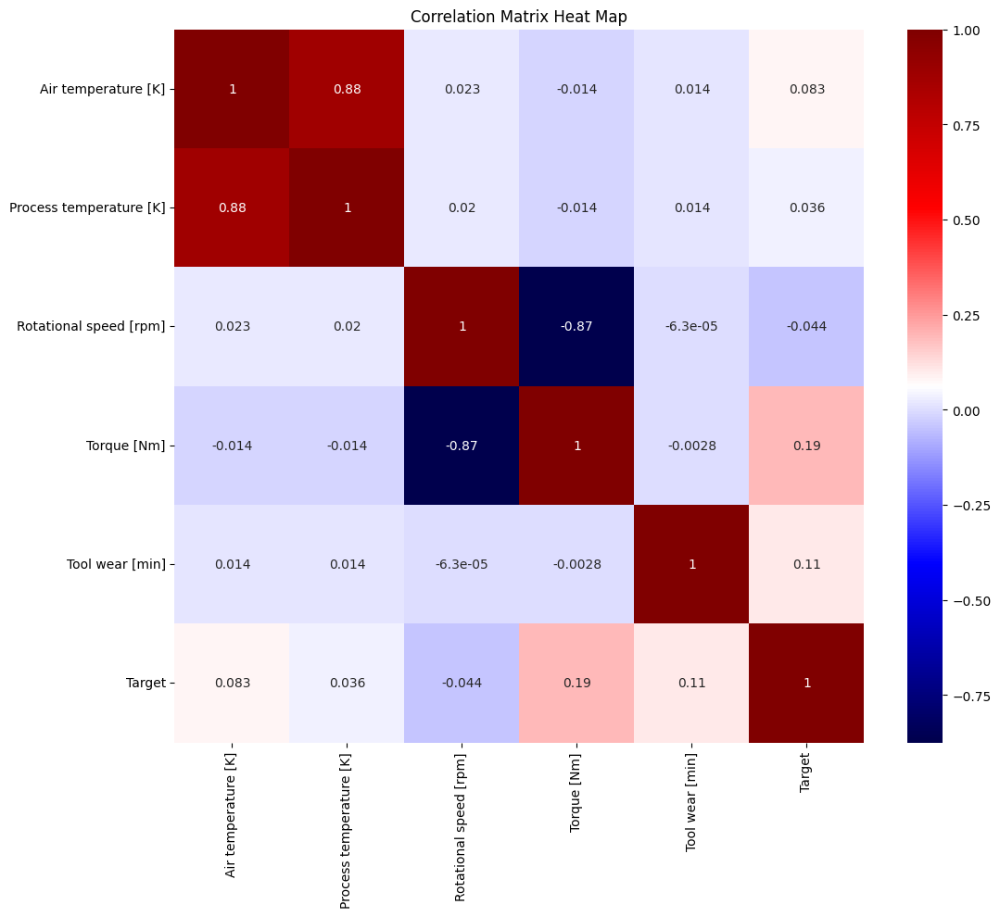

In [82]:
# Get correlation matrix from dataset without Ids
df_corr = df.drop(['UDI', 'Product ID'], axis=1)
cor = df_corr.corr()

# plot heat map for the correlation matrix
plt.figure(figsize=(12,10))
sns.heatmap(cor, annot=True, cmap=plt.cm.seismic)
plt.title('Correlation Matrix Heat Map')
plt.show()

## Data Preparation

### Handle Outliers

The dataset initially contained **9991** rows, with 'No Failure' being the most common category. Outliers were identified and removed from the 'Rotational speed [rpm]', 'Torque [Nm]', and 'Tool wear [min]' columns, resulting in a final dataset of **9526** rows. The distribution of failure types was slightly altered after outlier removal. This process is essential for ensuring the reliability of further analysis or model training, as outliers can skew results and reduce prediction accuracy.

<AxesSubplot:>

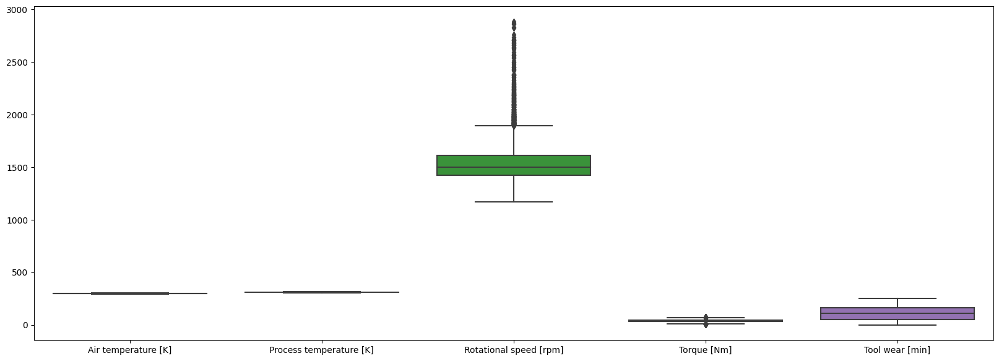

In [104]:
# Check distribution and ranges of feature variables
plt.figure(figsize=(20,7))
sns.boxplot(data = df_final.drop(object_cols, axis=1))

In [105]:
# Copy dataframe
df_no_outliers = df_final.copy()
print(f'Total rows with outliers: {df_no_outliers.shape[0]}')

# Loop through numerical columns
for col in df_final.drop(object_cols, axis=1).columns:
    # Calculate IQR
    Q1 = df_no_outliers[col].quantile(0.25)
    Q3 = df_no_outliers[col].quantile(0.75)
    IQR = Q3 - Q1
    # Define bounds for outliers
    lower_bound = Q1 - (1.5 * IQR)
    upper_bound = Q3 + (1.5 * IQR)
    # Remove outliers
    df_no_outliers = df_no_outliers[(df_no_outliers[col] >= lower_bound) & (df_no_outliers[col] <= upper_bound)]
    # Print total number of rows after removal of outliers
    print(f'Total rows with out outliers for column {col} : {df_no_outliers.shape[0]}')

Total rows with outliers: 9991
Total rows with out outliers for column Air temperature [K] : 9991
Total rows with out outliers for column Process temperature [K] : 9991
Total rows with out outliers for column Rotational speed [rpm] : 9573
Total rows with out outliers for column Torque [Nm] : 9526
Total rows with out outliers for column Tool wear [min] : 9526


<AxesSubplot:>

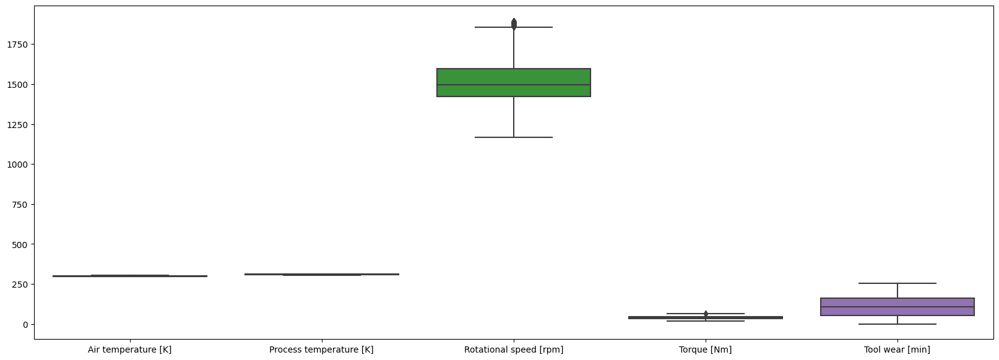

In [107]:
# Check distribution and ranges of feature variables after removing outliers
plt.figure(figsize=(20,7))
sns.boxplot(data = df_no_outliers.drop(object_cols, axis=1))

In [110]:
df_no_outliers['Failure Type'].value_counts()

No Failure                  9254
Heat Dissipation Failure     110
Overstrain Failure            76
Tool Wear Failure             41
Power Failure                 27
Random Failures               18
Name: Failure Type, dtype: int64

### Handle Categorical Variables

Categorical variables in the dataset were handled through integer encoding which involves converting each category value into a unique integer, making the data more suitable for machine learning algorithmic processing.

The 'Failure Type' variable was encoded as follows:
- 'Heat Dissipation Failure': **0**
- 'No Failure': **1**
- 'Overstrain Failure': **2**
- 'Power Failure': **3**
- 'Random Failures': **4**
- 'Tool Wear Failure': **5**

Similarly, the 'Type' variable was encoded with the following mapping:
- 'H': **0**
- 'L': **1**
- 'M': **2**

In [114]:
# Encode labels with value between 0 and n_classes-1

# Create a copy of df for encoding
df_le = df_no_outliers.copy()

# Initialize a LabelEncoder
le = LabelEncoder()

# Fit and transform the 'Failure Type' column
df_le['Failure Type'] = le.fit_transform(df_le['Failure Type'])

# Get the mapping of original labels to integer codes for 'Failure Type'
machineFailureType_mapping = dict(zip(le.classes_, range(len(le.classes_))))

print("'Failure Type' integer mapping after encoding: \r\n", machineFailureType_mapping, '\r\n')

# Fit and transform the 'Type' column
df_le['Type'] = le.fit_transform(df_le['Type'])

# Get the mapping of original labels to integer codes for 'Type'
type_mapping = dict(zip(le.classes_, range(len(le.classes_))))

print("'Type' integer mapping after encoding: \r\n", type_mapping, '\r\n')

# Print label encoded dataset
print("Label encoded dataset: \r\n", df_le.head(), '\r\n')

'Failure Type' integer mapping after encoding: 
 {'Heat Dissipation Failure': 0, 'No Failure': 1, 'Overstrain Failure': 2, 'Power Failure': 3, 'Random Failures': 4, 'Tool Wear Failure': 5} 

'Type' integer mapping after encoding: 
 {'H': 0, 'L': 1, 'M': 2} 

Label encoded dataset: 
    Type  Air temperature [K]  Process temperature [K]  Rotational speed [rpm]  \
0     2                298.1                    308.6                    1551   
1     1                298.2                    308.7                    1408   
2     1                298.1                    308.5                    1498   
3     1                298.2                    308.6                    1433   
4     1                298.2                    308.7                    1408   

   Torque [Nm]  Tool wear [min]  Failure Type  
0         42.8                0             1  
1         46.3                3             1  
2         49.4                5             1  
3         39.5                7      

### Seperate Features and Targets

In [115]:
df_model = df_le.copy()

# Set target column
target_column = ['Failure Type']

# Separate features and targets
X = df_model.drop(target_column, axis=1)  # Features
y = df_model[target_column]  # Target

### Scaling Features Using MinMaxScaler

Feature scaling is a crucial step in preprocessing data for machine learning models. It ensures that all features have a similar scale, preventing any one feature from dominating others due to its range of values. The MinMaxScaler was used to scale the features in this dataset. Before scaling, the features had different ranges. For example, 'Rotational speed [rpm]' ranged from **1168** to **1895**, while 'Tool wear [min]' ranged from **0** to **253**. After applying MinMaxScaler, all features were transformed to a common scale ranging from **0** to **1**. The mean, standard deviation, and quartiles were also adjusted accordingly. This scaling process helps ensure that all features contribute equally to the model's performance, regardless of their original scales.

In [116]:
# Descriptive statistics of features dataframe
X.describe()

,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min]
count,9526.000000,9526.000000,9526.000000,9526.000000,9526.000000,9526.000000
mean,1.198719,299.993145,310.000147,1515.348100,40.766009,108.010078
std,0.601034,1.995616,1.481478,129.765411,8.899382,63.583716
min,0.000000,295.300000,305.700000,1168.000000,20.100000,0.000000
25%,1.000000,298.300000,308.800000,1421.000000,34.200000,53.000000
50%,1.000000,300.100000,310.100000,1497.000000,40.500000,108.000000
75%,2.000000,301.500000,311.100000,1595.000000,47.000000,162.000000
max,2.000000,304.500000,313.800000,1895.000000,66.400000,253.000000


In [117]:
# Scale and transform features to a defined range (0-1)
minMaxScaler = preprocessing.MinMaxScaler()

# Fit and transform MinMaxScaler
scaled_data = minMaxScaler.fit_transform(X)

# Convert the scaled data back into a DataFrame and assign column names
X_scaled = pd.DataFrame(scaled_data, columns=X.columns)

# Descriptive statistics of features dataframe after MinMaxScaling
X_scaled.describe()

,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min]
count,9526.000000,9526.000000,9526.000000,9526.000000,9526.000000,9526.000000
mean,0.599360,0.510124,0.530882,0.477783,0.446350,0.426917
std,0.300517,0.216915,0.182899,0.178494,0.192211,0.251319
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.500000,0.326087,0.382716,0.348006,0.304536,0.209486
50%,0.500000,0.521739,0.543210,0.452545,0.440605,0.426877
75%,1.000000,0.673913,0.666667,0.587345,0.580994,0.640316
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<AxesSubplot:>

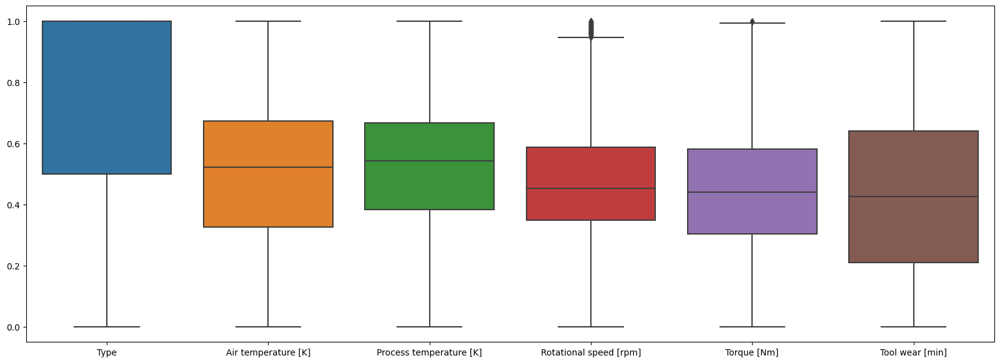

In [118]:
# check distribution and ranges of feature variables after MinMaxScaling
plt.figure(figsize=(20,7))
sns.boxplot(data = X_scaled)

### Handle Imbalanced Data

Imbalanced data can pose a challenge in machine learning models, as they may lead to biased predictions towards the majority class. In this dataset, the 'Failure Type' variable was initially imbalanced, with 'No Failure' (**9254** instances) being the most common category, and 'Random Failures' (**18** instances) being the least common. To address this issue, Random Over-Sampling was implemented. This technique works by randomly duplicating instances from the minority class to increase their representation. After applying Random Over-Sampling, each 'Failure Type' category had an equal representation of **9254** instances. This process helps to balance the classes in the dataset, improving the model's ability to generalize and make accurate predictions for all classes. 

In [119]:
# Check for imbalance in target variable
y.value_counts()

Failure Type
1               9254
0                110
2                 76
5                 41
3                 27
4                 18
dtype: int64

In [120]:
# Implement Random Over-Sampling to avoid imbalnce in data by randomly duplicating examples in the minority class.
ros = RandomOverSampler(random_state=0)
X_resampled, y_resampled = ros.fit_resample(X_scaled, y)

In [121]:
# Check for imbalance in target variable after over sampling
y_resampled.value_counts()

Failure Type
0               9254
1               9254
2               9254
3               9254
4               9254
5               9254
dtype: int64

<AxesSubplot:>

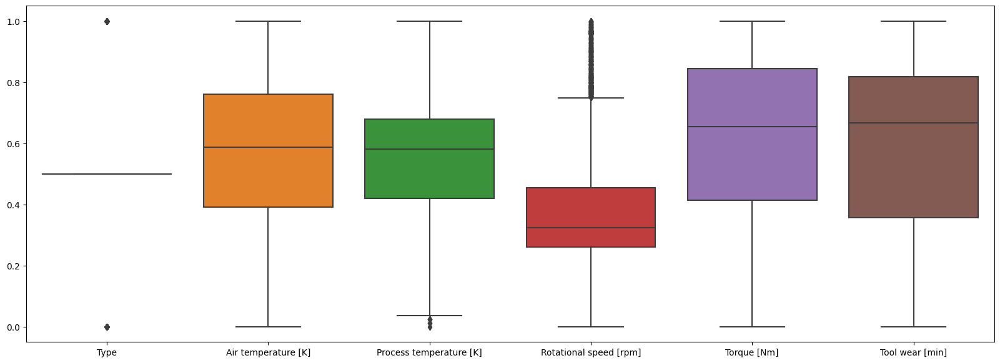

In [122]:
# check distribution and ranges of feature variables after Random Over-Sampling
plt.figure(figsize=(20,7))
sns.boxplot(data = X_resampled)

## Model Selection and Evaluation

### Feature Selection

Feature selection is a pivotal process in machine learning, aiming to identify the most relevant variables for predictive modeling. Based on the data analyses and correlation amtrix, the following features have been selected:

- The direct and consistent relationship between **air and process temperatures**, highlights their importance in temperature regulation within industrial settings. The lower variability in process temperature suggests it's a stable feature for models predicting operational efficiency. 
- The inverse relationship between **rotational speed and torque** is critical for mechanical system design. Features capturing this relationship can significantly enhance models aimed at optimizing mechanical performance. 
- The correlation between **product quality and tool wear time** underscores the impact of high-quality products on maintenance schedules. This feature is essential for models that aim to predict and plan for tool replacements, ensuring uninterrupted production. 

These features were chosen for their strong relationships and implications on the operational aspects they represent, making them valuable for inclusion in predictive models.

### Split Dataset

In [125]:
# Splitting dataset into training set and test set (80% training and 20% test)
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=0)

### Decision Tree
The Decision Tree Classifier exhibits exceptional performance with perfect training accuracy and near-perfect test accuracy, indicating high generalizability. Despite concerns of overfitting due to perfect training scores, the model's robustness is affirmed by its test accuracy. Parameter adjustments did not alter performance, suggesting initial optimization or parameter insensitivity for this dataset.

In [126]:
# Building the Decision Tree
clf = tree.DecisionTreeClassifier() # Create Decision Tree classifer object
clf = clf.fit(X_train, y_train) # Train Decision Tree Classifer

In [127]:
# Evaluating the Tree model
clf_y_hat = clf.predict(X_train) # Predict the response for train dataset
clf_y_pred = clf.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, clf_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, clf_y_pred))

Train Accuracy: 1.0
Test Accuracy: 0.9979288608734804


Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize

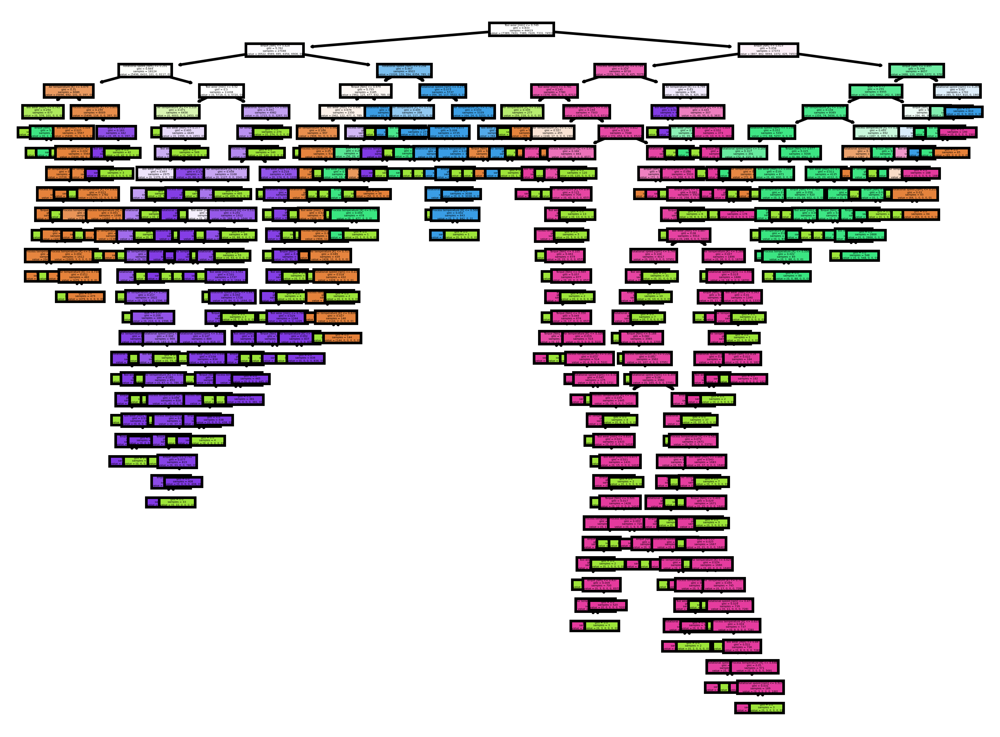

In [128]:
# Visualizing the Tree
plt.rcParams['figure.dpi'] = 500 # To increase the resolution from 100dpi to 500dpi
f_names=list(X_resampled.columns) # Feature names
tree.plot_tree(clf, filled=True, feature_names=f_names) # Plot the tree
plt.show() # Show without the rules in plain text

Train Accuracy: 1.0
Test Accuracy: 0.9979288608734804


Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.19 < 1.0 pt not allowed by FreeType. Setting fontsize

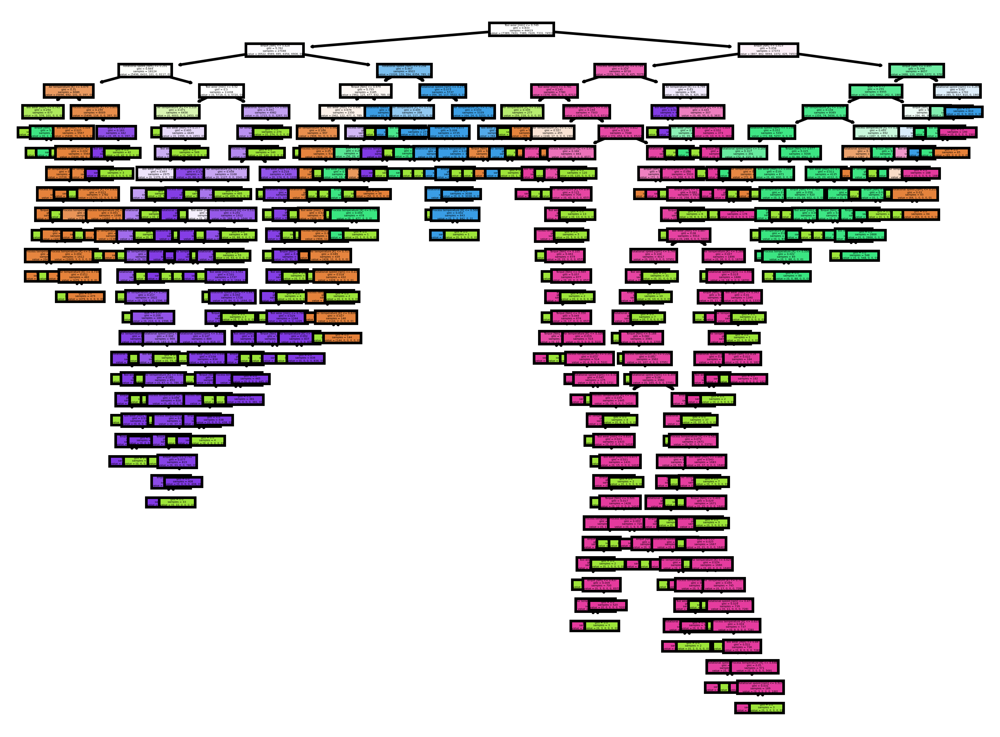

In [129]:
# Tuning the tree
# Create Decision Tree classifer object by spefifying parameters
# Try using max_depth=2, min_samples_split=5000, min_samples_leaf=50, criterion="entropy"
clf_tune = tree.DecisionTreeClassifier(max_depth=2, min_samples_split=5000, min_samples_leaf=50, criterion='entropy') 

# Train and test the classifier
clf_tune = clf_tune.fit(X_train, y_train) # Train Decision Tree Classifer
clf_tune_y_hat = clf.predict(X_train) # Predict the response for train dataset
clf_tune_y_pred = clf.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, clf_tune_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, clf_tune_y_pred))

plt.rcParams['figure.dpi'] = 500 # To increase the resolution from 100dpi to 500dpi

# Plot the tree
f_names=list(X_resampled.columns) # Feature names
tree.plot_tree(clf, filled=True, feature_names=f_names) # Plot the tree
plt.show() # Show without the rules in plain text

### Random Forest
The initial Random Forest Classifier achieved a training accuracy of 1.0 and test accuracy of 0.9996, suggesting high performance. However, to address potential overfitting, hyperparameter tuning was conducted, resulting in optimal parameters of a max depth of 14 and 55 estimators. Post-tuning, a slight decrease in accuracy was observed (training: 0.9989, test: 0.9972), which may indicate improved generalization capabilities for new, unseen data.

In [130]:
# Building the Random Forest
rf = RandomForestClassifier(random_state=0) # Create Random Forest classifer object
rf = rf.fit(X_train, y_train) # Train Random Forest Classifer

In [131]:
# Evaluating the RF model
rf_y_hat = rf.predict(X_train) # Predict the response for train dataset
rf_y_pred = rf.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, rf_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, rf_y_pred))

Train Accuracy: 1.0
Test Accuracy: 0.9996398018910401


In [132]:
# Visualizing few trees of the RF
f_names=list(X_resampled.columns) # Feature names
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,2), dpi=3000) # Setup the 1x2 grid for ploting the trees
for index in range(0, 2): # Iterate through the first five trees (of 100)
  tree.plot_tree(rf.estimators_[index], feature_names=f_names, filled = True, ax=axes[index]); # Plot the tree
  axes[index].set_title('Estimator: ' + str(index), fontsize = 11) # Print title

Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.08 < 1.0 pt not allowed by FreeType. Setting fontsize

In [133]:
# Hyperparameter search
param_dist = {'n_estimators': randint(50,500), 'max_depth': randint(1,20)} # Search ranges
rand_search = RandomizedSearchCV(rf, param_distributions=param_dist, n_iter=5, cv=5) # Use random search to find the best hyperparameters
rand_search.fit(X_train, y_train) # Fit the random search object to the training data

# Print the best hyperparameters
print('Best hyperparameters:',  rand_search.best_params_)

best_rf = rand_search.best_estimator_ # Capture the best model
best_rf_y_hat = best_rf.predict(X_train) # Predict the response for train dataset
best_rf_y_pred = best_rf.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, best_rf_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, best_rf_y_pred))

Best hyperparameters: {'max_depth': 14, 'n_estimators': 55}
Train Accuracy: 0.998964407123078
Test Accuracy: 0.9972084646555606


### XGBOOST
The initial XGBoost Classifier model showed a perfect training accuracy of 1.0 and a very high test accuracy of 0.9987, which might indicate overfitting. Hyperparameter optimization was performed with parameters such as a learning rate of 0.05, max depth of 10, 20 estimators, etc.
After optimization, the training and test accuracies decreased to 0.9915 and 0.9893 respectively, which could indicate better generalization to unseen data.


In [141]:
# Remove special characters in the column names
print(X_train.columns)

X_bst_train = X_train.copy()

X_bst_train.columns = X_bst_train.columns.str.replace('[', '')
X_bst_train.columns = X_bst_train.columns.str.replace(']', '')
X_bst_train.columns = X_bst_train.columns.str.replace('<', '')


Index(['Type', 'Air temperature [K]', 'Process temperature [K]',
       'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]'],
      dtype='object')


In [142]:
# Building the XGBOOST
bst = XGBClassifier().fit(X_bst_train, y_train)
bst_y_hat = bst.predict(X_bst_train) # Predict the response for train dataset
bst_y_pred = bst.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, bst_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, bst_y_pred))

Train Accuracy: 1.0
Test Accuracy: 0.9987393066186403


In [143]:
# Hyperparameter optimization
# Experiment with learning rate, number of trees, subsample

bst_hyp = XGBClassifier(learning_rate = 0.05, 
                        max_depth = 10, 
                        n_estimators = 20, 
                        objective='multi:softproba', 
                        num_class=3,
                        subsample = 0.8) # Lowering subsample will reduce data available in each tree
bst_hyp_mod = bst_hyp.fit(X_bst_train, y_train)
                        
bst_hyp_y_hat = bst_hyp_mod.predict(X_bst_train) # Predict the response for train dataset
bst_hyp_y_pred = bst_hyp_mod.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, bst_hyp_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, bst_hyp_y_pred)) 

Train Accuracy: 0.9914901280983363
Test Accuracy: 0.9892841062584421


### Stacking
The initial Stacking Classifier, with a Random Forest Classifier and a Linear SVC as base estimators, and a Logistic Regression as the final estimator, showed almost perfect training accuracy and very high test accuracy, indicating potential overfitting. Cross validation with RandomizedSearchCV was implemented for hyperparameter tuning, finding optimal parameters for both the Random Forest Classifier and the Linear SVC.
After tuning and cross validation, both training and test accuracies decreased slightly, which could suggest better generalization to unseen data.

In [145]:
# Stacking involves training a model to combine the predictions of several other models.
estimators = [
    ('rf', RandomForestClassifier(n_estimators=10, random_state=0)),
    ('svr', make_pipeline(StandardScaler(), LinearSVC(random_state=0)))
]
sc = StackingClassifier(estimators=estimators, final_estimator=LogisticRegression())
sc_mod = sc.fit(X_train, y_train)
                        
sc_y_hat = sc_mod.predict(X_train) # Predict the response for train dataset
sc_y_pred = sc_mod.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, sc_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, sc_y_pred))

Train Accuracy: 0.9999774871113712
Test Accuracy: 0.99990995047276


In [146]:
# Define the parameter distribution
param_dist = {
    'rf__n_estimators': randint(10, 200),
    'rf__max_depth': randint(5, 10),
    'svr__linearsvc__C': [0.1, 1.0, 10.0, 100.0]
}

# Initialize RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=sc,
    param_distributions=param_dist,
    n_iter=5,  # Smaller number of iterations
    cv=3,  # Cross-validation folds
    verbose=2,
    random_state=0  # Use parallel computation
)

# Fit RandomizedSearchCV
random_search.fit(X_train, y_train)

# Get the best parameters
best_params = random_search.best_params_


Fitting 3 folds for each of 5 candidates, totalling 15 fits
[CV] END rf__max_depth=9, rf__n_estimators=57, svr__linearsvc__C=1.0; total time=  15.3s
[CV] END rf__max_depth=9, rf__n_estimators=57, svr__linearsvc__C=1.0; total time= 1.6min
[CV] END rf__max_depth=9, rf__n_estimators=57, svr__linearsvc__C=1.0; total time= 1.1min
[CV] END rf__max_depth=5, rf__n_estimators=77, svr__linearsvc__C=100.0; total time=  26.9s
[CV] END rf__max_depth=5, rf__n_estimators=77, svr__linearsvc__C=100.0; total time=  25.0s
[CV] END rf__max_depth=5, rf__n_estimators=77, svr__linearsvc__C=100.0; total time=  25.0s
[CV] END rf__max_depth=8, rf__n_estimators=113, svr__linearsvc__C=1.0; total time=  17.5s
[CV] END rf__max_depth=8, rf__n_estimators=113, svr__linearsvc__C=1.0; total time=  18.2s
[CV] END rf__max_depth=8, rf__n_estimators=113, svr__linearsvc__C=1.0; total time=  19.4s
[CV] END rf__max_depth=8, rf__n_estimators=31, svr__linearsvc__C=10.0; total time=  19.7s
[CV] END rf__max_depth=8, rf__n_estimato

In [147]:
# Best params with random search
print(best_params)

{'rf__max_depth': 9, 'rf__n_estimators': 97, 'svr__linearsvc__C': 10.0}


In [148]:
sc_tune_y_hat = random_search.predict(X_train) # Predict the response for train dataset
sc_tune_y_pred = random_search.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, sc_tune_y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, sc_tune_y_pred))

Train Accuracy: 0.9983115333528445
Test Accuracy: 0.9970283656010805


### Model Metric Comparison
1. **Decision Tree Classifier**:
    - Initial Model: High accuracy, precision, recall, and F1-score. AUC-ROC score is also high.
    - After Parameter Adjustment: Metrics remain high, but AUC-ROC score decreases significantly, indicating a possible decrease in the model’s ability to distinguish between classes.
2. **Random Forest Classifier**:
    - Initial Model: Almost perfect scores in all metrics.
    - After Hyperparameter Search: Slight decrease in scores but they remain high, indicating that the model is likely generalizing well.
3. **XGBoost Classifier**:
    - Initial Model: Almost perfect scores in all metrics.
    - After Hyperparameter Optimization: Scores decrease but remain high, indicating good generalization. However, the decrease in scores is larger compared to the Random Forest model, suggesting that the XGBoost model is more sensitive to the hyperparameter changes.
4. **Stacking Classifier**:
    - Initial Model: Perfect scores in all metrics.
    - After Cross-Validation and Hyperparameter Tuning: Slight decrease in scores but they remain high, indicating that the model is likely generalizing well.
In summary, all models show high performance, and the adjustments in hyperparameters and the use of cross-validation seem to help the models generalize better without memorizing the training data.

Decision Tree Classification Report:
Accuracy: 0.9979288608734804
Precision: 0.9979358792139889
Recall: 0.9979288608734804
F1-Score: 0.9979240447035749
AUC-ROC: 0.9987411194820138
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      0.99      0.99      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       1.00      1.00      1.00      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



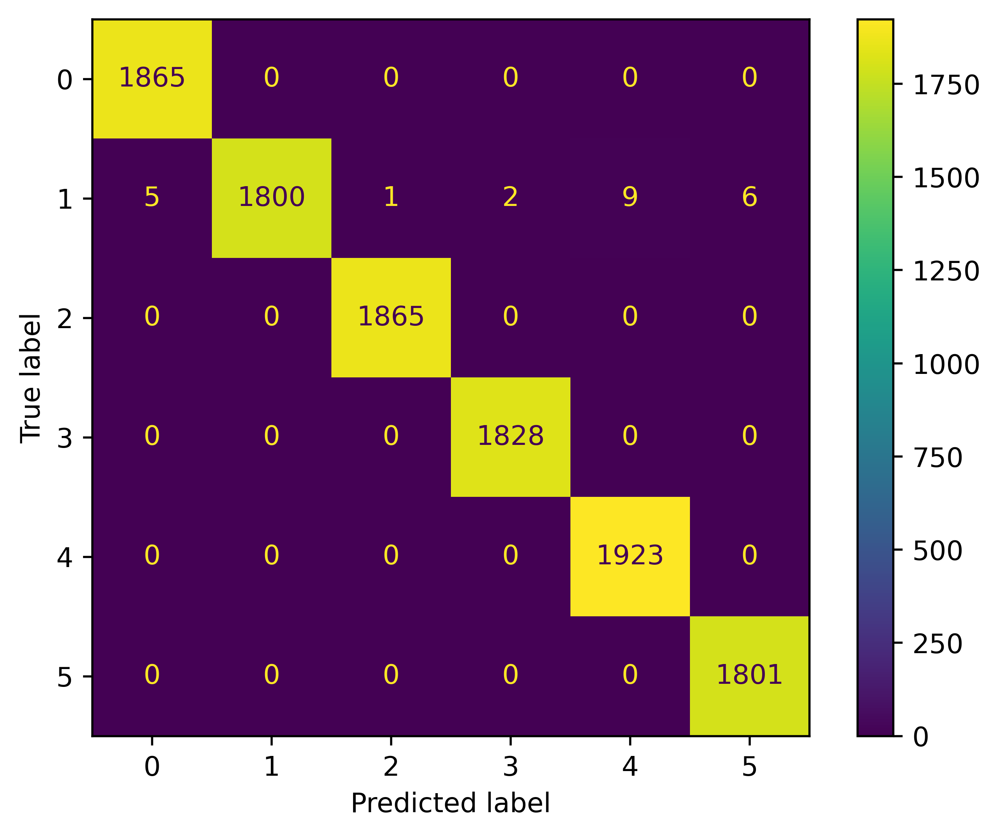

In [149]:
# Decision Tree
# Calculate predicted probabilities for each class
clf_probs = clf.predict_proba(X_test)
print('Decision Tree Classification Report:')
print("Accuracy:", metrics.accuracy_score(y_test, clf_y_pred))
print("Precision:", metrics.precision_score(y_test, clf_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, clf_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, clf_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, clf_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, clf_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, clf_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

Tuned Decision Tree Classification Report:
Accuracy: 0.9979288608734804
Precision: 0.9979358792139889
Recall: 0.9979288608734804
F1-Score: 0.9979240447035749
AUC-ROC: 0.860654230983135
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      0.99      0.99      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       1.00      1.00      1.00      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



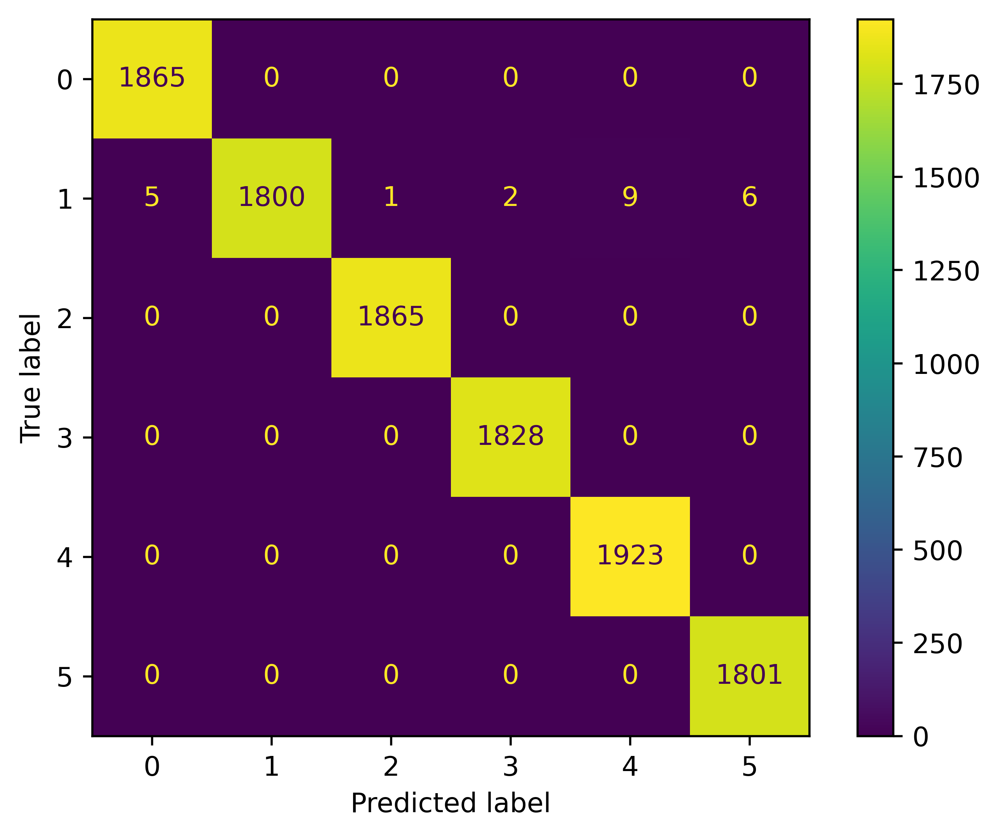

In [150]:
# Tuned Decision Tree
# Calculate predicted probabilities for each class
clf_tune_probs = clf_tune.predict_proba(X_test)
print('Tuned Decision Tree Classification Report:')
print("Accuracy:", metrics.accuracy_score(y_test, clf_tune_y_pred))
print("Precision:", metrics.precision_score(y_test, clf_tune_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, clf_tune_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, clf_tune_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, clf_tune_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, clf_tune_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, clf_tune_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

Random Forest Classification Report:
Accuracy: 0.9996398018910401
Precision: 0.9996400930499051
Recall: 0.9996398018910401
F1-Score: 0.9996396769109389
AUC-ROC: 1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      1.00      1.00      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       1.00      1.00      1.00      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



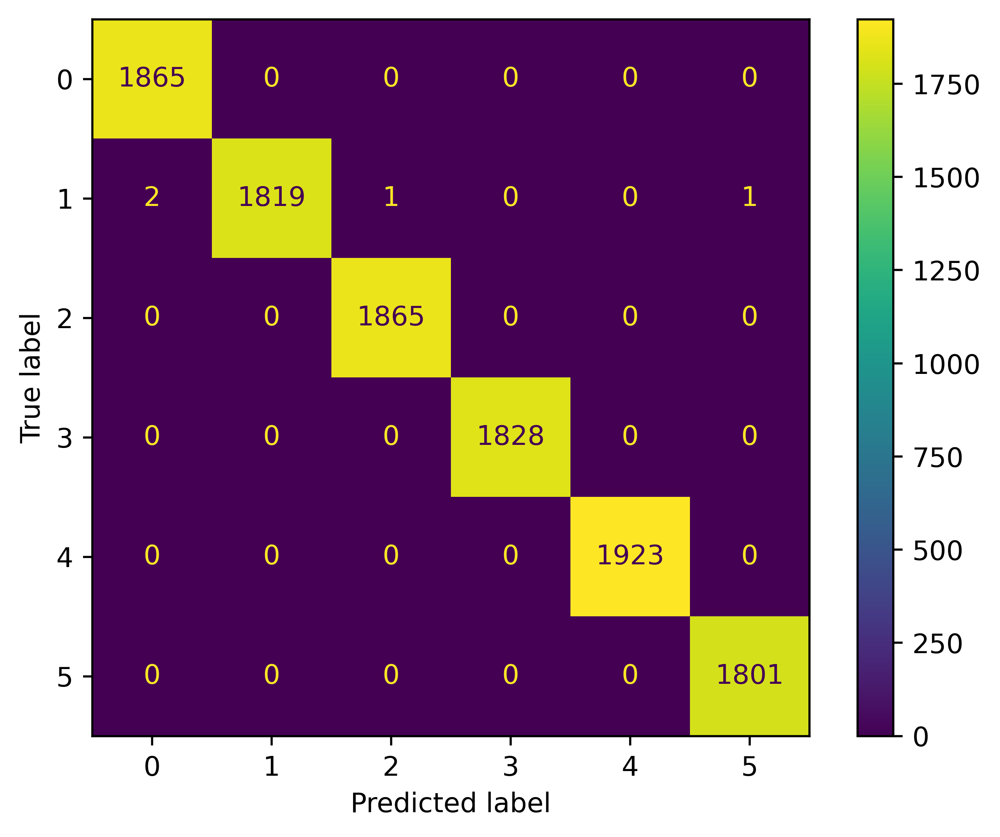

In [151]:
# Random Forest
# Calculate predicted probabilities for each class
rf_probs = rf.predict_proba(X_test)
print('Random Forest Classification Report:')
print("Accuracy:", metrics.accuracy_score(y_test, rf_y_pred))
print("Precision:", metrics.precision_score(y_test, rf_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, rf_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, rf_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, rf_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, rf_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, rf_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

Best Hypermeter Serach Random Forest Classification Report:
Accuracy: 0.9972084646555606
Precision: 0.997240152596811
Recall: 0.9972084646555606
F1-Score: 0.9972044707269764
AUC-ROC: 1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      0.98      0.99      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       0.99      1.00      0.99      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



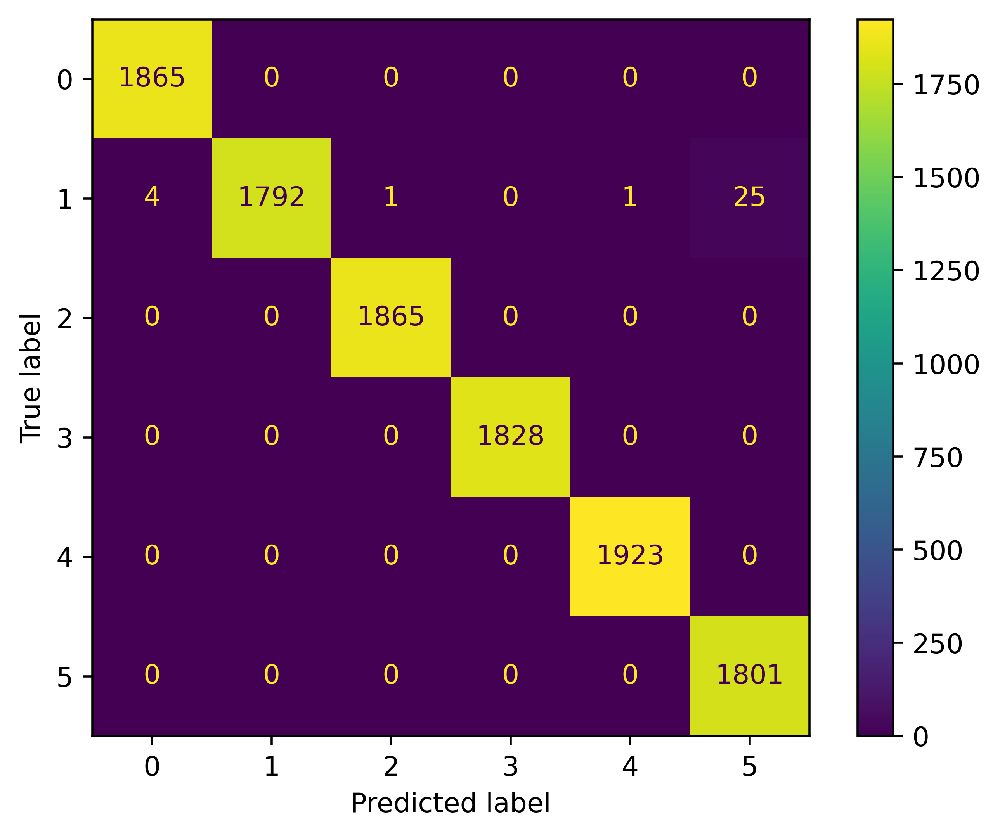

In [152]:
# Best Hypermeter Serach Random Forest
# Calculate predicted probabilities for each class
best_rf_probs = best_rf.predict_proba(X_test)
print('Best Hypermeter Serach Random Forest Classification Report:')
print("Accuracy:", metrics.accuracy_score(y_test, best_rf_y_pred))
print("Precision:", metrics.precision_score(y_test, best_rf_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, best_rf_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, best_rf_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, best_rf_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, best_rf_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, best_rf_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

XGBOOST Report:
Accuracy: 0.9987393066186403
Precision: 0.9987429743456764
Recall: 0.9987393066186403
F1-Score: 0.9987377956230467
AUC-ROC: 0.9999362158723523
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      0.99      1.00      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       1.00      1.00      1.00      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



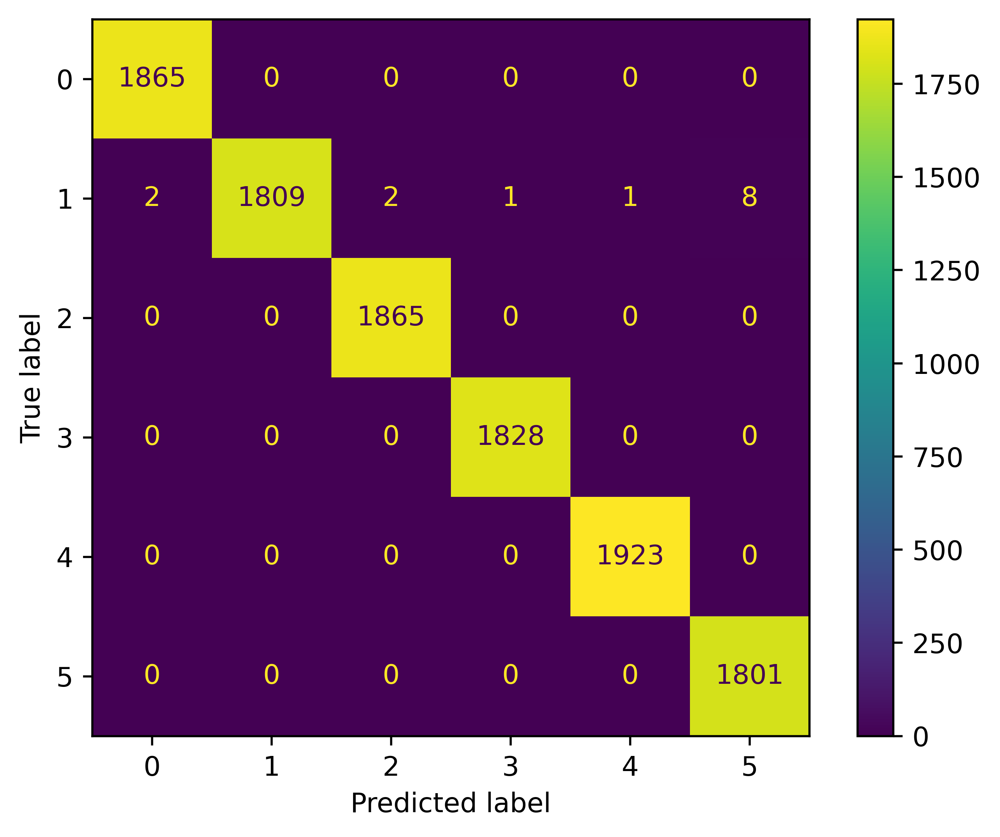

In [153]:
# XGBOOST
# Calculate predicted probabilities for each class
bst_probs = bst.predict_proba(X_test)
print('XGBOOST Report:')
print("Accuracy:", metrics.accuracy_score(y_test, bst_y_pred))
print("Precision:", metrics.precision_score(y_test, bst_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, bst_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, bst_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, bst_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, bst_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, bst_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

Best Hypermeter Optimization XGBOOST Report:
Accuracy: 0.9892841062584421
Precision: 0.9895123568849247
Recall: 0.9892841062584421
F1-Score: 0.9891611659130715
AUC-ROC: 0.9998413295515083
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      1865
           1       1.00      0.93      0.97      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       0.99      1.00      0.99      1923
           5       0.97      1.00      0.98      1801

    accuracy                           0.99     11105
   macro avg       0.99      0.99      0.99     11105
weighted avg       0.99      0.99      0.99     11105



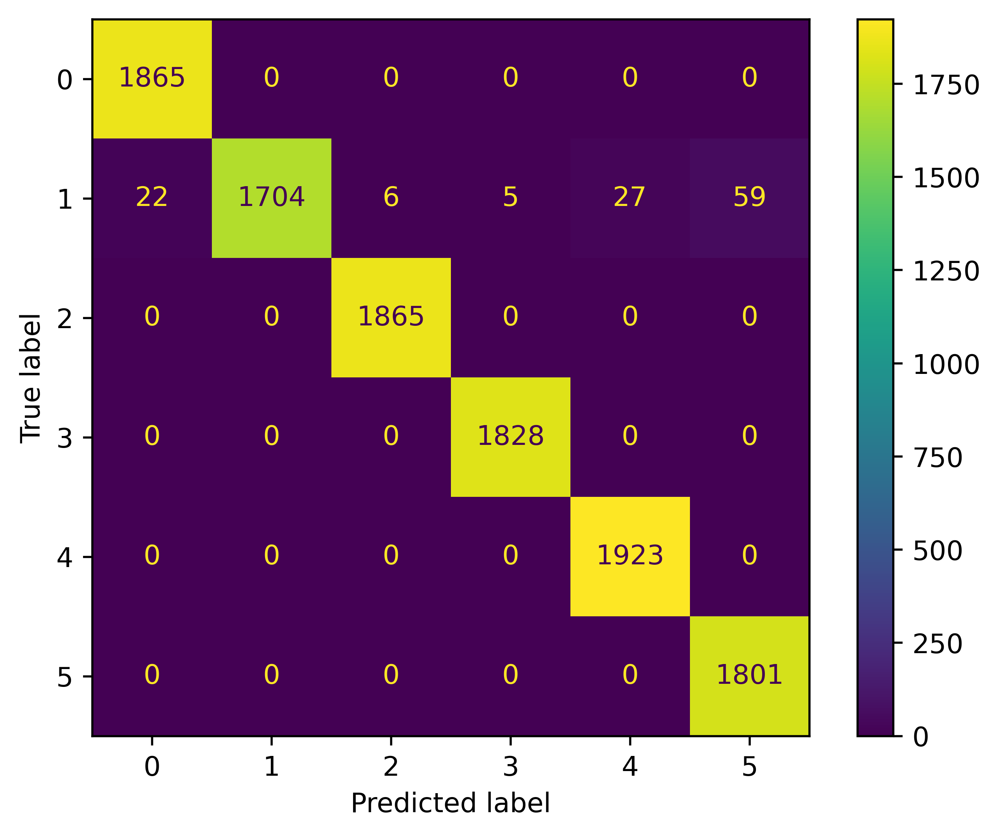

In [154]:
# Best Hypermeter Optimization XGBOOST
# Calculate predicted probabilities for each class
bst_hyp_probs = bst_hyp_mod.predict_proba(X_test)
print('Best Hypermeter Optimization XGBOOST Report:')
print("Accuracy:", metrics.accuracy_score(y_test, bst_hyp_y_pred))
print("Precision:", metrics.precision_score(y_test, bst_hyp_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, bst_hyp_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, bst_hyp_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, bst_hyp_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, bst_hyp_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, bst_hyp_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

Stacking Classifier Report:
Accuracy: 0.99990995047276
Precision: 0.999909999707056
Recall: 0.99990995047276
F1-Score: 0.999909950432227
AUC-ROC: 1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      1.00      1.00      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       1.00      1.00      1.00      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



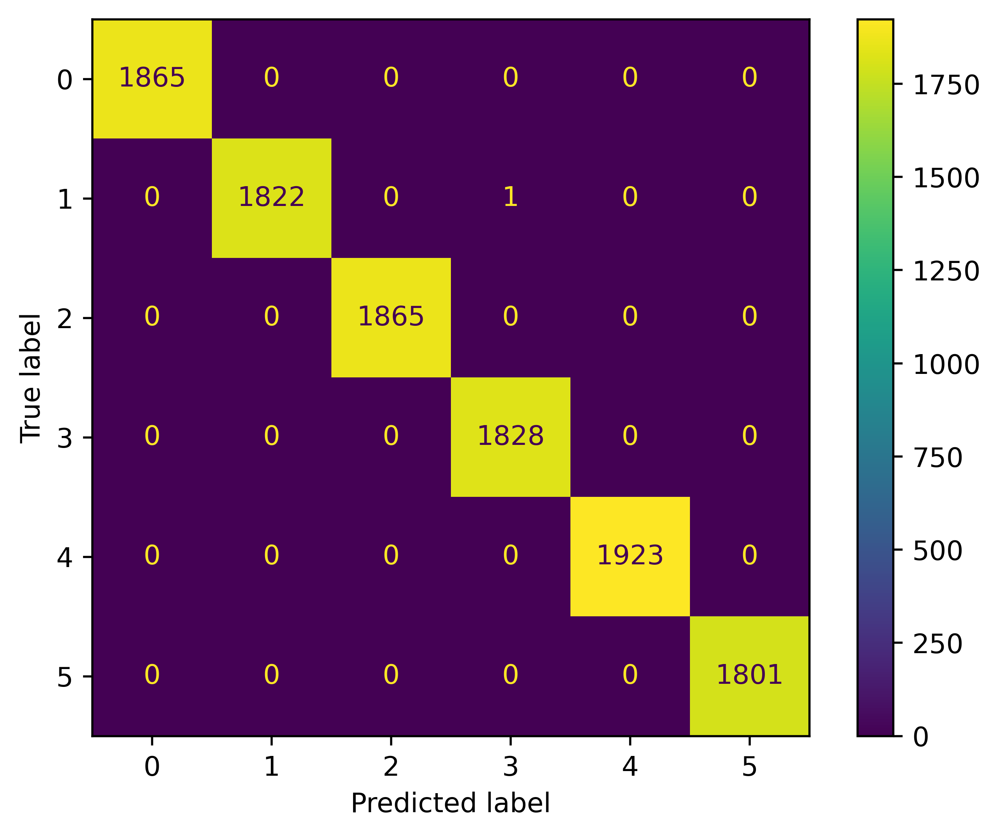

In [155]:
# Stacking Classifier
# Calculate predicted probabilities for each class
sc_probs = sc_mod.predict_proba(X_test)
print('Stacking Classifier Report:')
print("Accuracy:", metrics.accuracy_score(y_test, sc_y_pred))
print("Precision:", metrics.precision_score(y_test, sc_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, sc_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, sc_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, sc_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, sc_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, sc_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()


Cross Validation and Hyperparameter Tuned Stacking Classifier Report:
Accuracy: 0.9970283656010805
Precision: 0.997058171322627
Recall: 0.9970283656010805
F1-Score: 0.9970222933899643
AUC-ROC: 0.9999847953488215
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1865
           1       1.00      0.98      0.99      1823
           2       1.00      1.00      1.00      1865
           3       1.00      1.00      1.00      1828
           4       1.00      1.00      1.00      1923
           5       0.99      1.00      0.99      1801

    accuracy                           1.00     11105
   macro avg       1.00      1.00      1.00     11105
weighted avg       1.00      1.00      1.00     11105



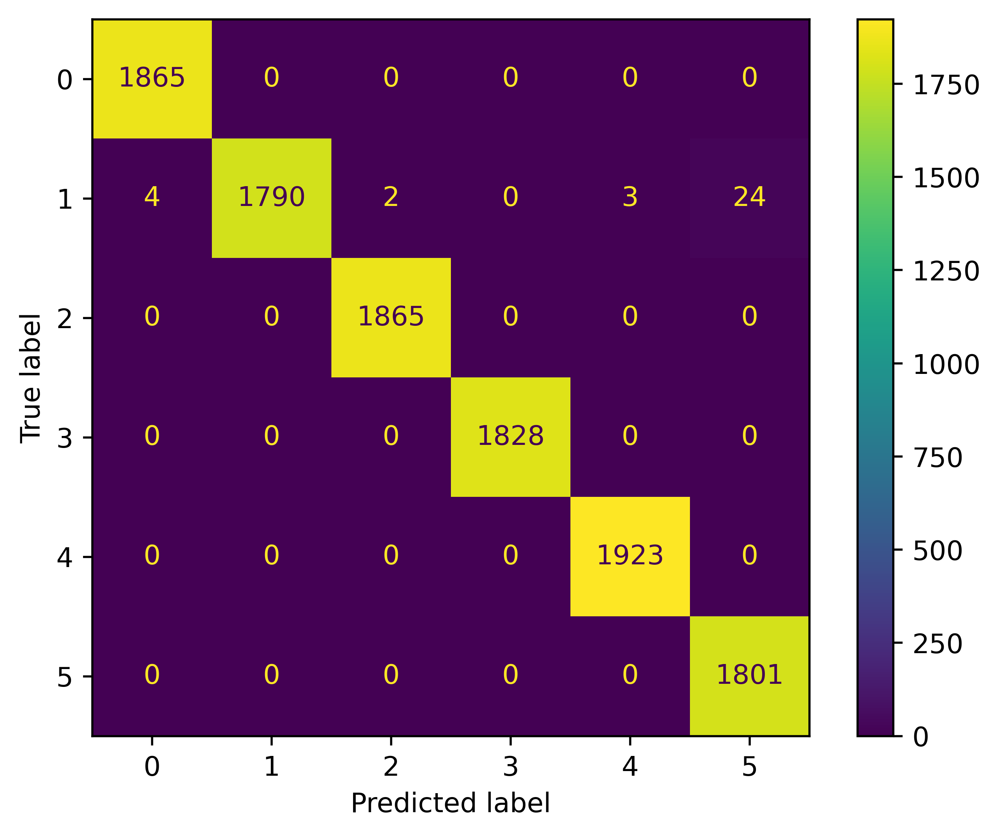

In [158]:
# Stacking Classifier After Hyperparameter Tuning
# Calculate predicted probabilities for each class
sc_tune_probs = random_search.predict_proba(X_test)
print('Cross Validation and Hyperparameter Tuned Stacking Classifier Report:')
print("Accuracy:", metrics.accuracy_score(y_test, sc_tune_y_pred))
print("Precision:", metrics.precision_score(y_test, sc_tune_y_pred, average = 'weighted'))
print("Recall:", metrics.recall_score(y_test, sc_tune_y_pred, average = 'weighted'))
print("F1-Score:", metrics.f1_score(y_test, sc_tune_y_pred, average = 'weighted'))
print("AUC-ROC:", metrics.roc_auc_score(y_test, sc_tune_probs, multi_class='ovr'))
print(metrics.classification_report(y_test, sc_tune_y_pred))

# Create the confusion matrix
cm = metrics.confusion_matrix(y_test, sc_tune_y_pred)
metrics.ConfusionMatrixDisplay(confusion_matrix=cm).plot()

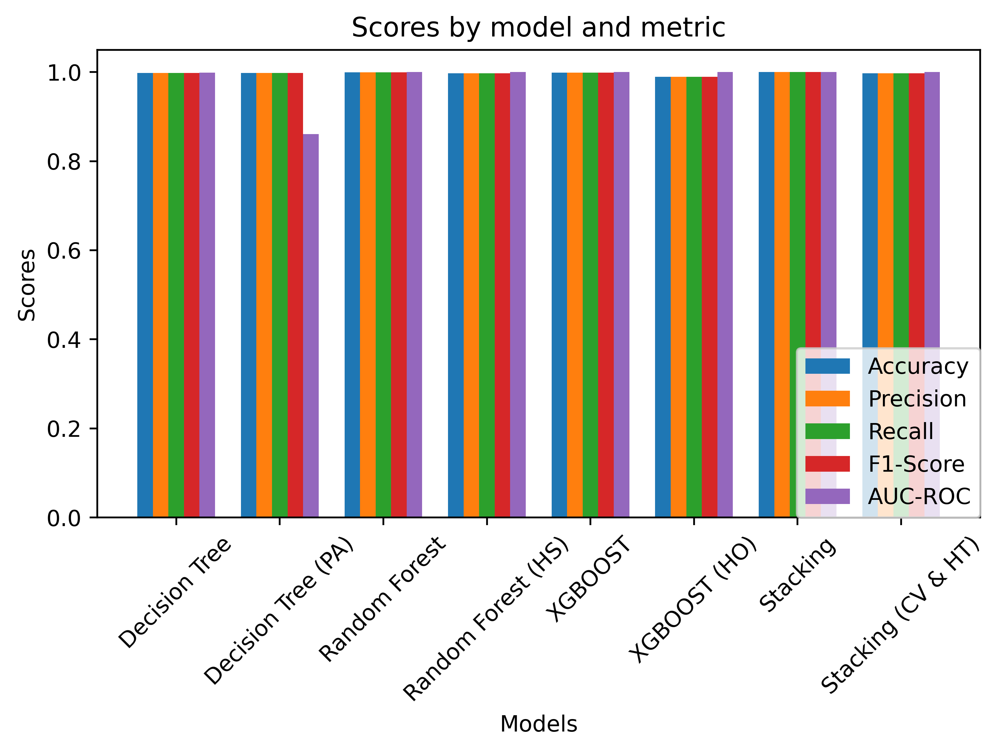

In [160]:
# Models array for comparison plot
# Decision Tree (PA) - Parameter Adjustment
# Random Forest (HS) - Hypermeter Serach
# XGBOOST (HO) - Hypermeter Optimization
# Stacking (CV & HT) - Cross Validation and Hyperparameter Tuning
models = ['Decision Tree', 'Decision Tree (PA)', 'Random Forest', 'Random Forest (HS)', 'XGBOOST', 'XGBOOST (HO)', 'Stacking', 'Stacking (CV & HT)']

# Replace these with your actual metrics
accuracy = [0.9979288608734804, 0.9979288608734804, 0.9996398018910401, 0.9972084646555606, 0.9987393066186403, 0.9892841062584421, 0.99990995047276, 0.9970283656010805]
precision = [0.9979358792139889, 0.9979358792139889, 0.9996400930499051, 0.997240152596811, 0.9987429743456764, 0.9895123568849247, 0.999909999707056, 0.997058171322627]
recall = [0.9979288608734804, 0.9979288608734804, 0.9996398018910401, 0.9972084646555606, 0.9987393066186403, 0.9892841062584421, 0.99990995047276, 0.9970283656010805]
f1_score = [0.9979240447035749, 0.9979240447035749, 0.9996396769109389, 0.9972044707269764, 0.9987377956230467, 0.9891611659130715, 0.999909950432227, 0.9970222933899643]
auc_roc = [0.9987411194820138, 0.860654230983135, 1.0, 1.0, 0.9999362158723523, 0.9998413295515083, 1.0, 0.9999847953488215]

# Create a grouped bar plot
x = np.arange(len(models))  # the label locations
width = 0.15  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - 2*width, accuracy, width, label='Accuracy')
rects2 = ax.bar(x - width, precision, width, label='Precision')
rects3 = ax.bar(x, recall, width, label='Recall')
rects4 = ax.bar(x + width, f1_score, width, label='F1-Score')
rects5 = ax.bar(x + 2*width, auc_roc, width, label='AUC-ROC')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_xlabel('Models')
ax.set_ylabel('Scores')
ax.set_title('Scores by model and metric')
ax.set_xticks(x)
ax.set_xticklabels(models, rotation=45)
ax.legend(bbox_to_anchor=(1, 0), loc='lower right', borderaxespad=0.)

fig.tight_layout()

plt.show()


## Discussion and conclusions

The primary objective of this project was to create a predictive model capable of precisely predicting the probability and nature of potential future machine failures. The models were trained on an extensive Predictive Maintenance Dataset that encompasses temperature metrics, machine measurement readings, variations in product quality, states of failure, and types of failure.

The models used in this project included a Decision Tree Classifier, a Random Forest Classifier, an XGBoost Classifier, and a Stacking Classifier. Each of these models showed high performance, with almost perfect scores in all metrics. After adjustments in hyperparameters and the use of cross-validation, the models generalized better without memorizing the training data.

The Decision Tree Classifier showed high accuracy, precision, recall, and F1-score both before and after parameter adjustment. However, the AUC-ROC score decreased significantly after parameter adjustment, which might indicate that the model’s ability to distinguish between classes has decreased.

The Random Forest Classifier showed almost perfect scores in all metrics. After hyperparameter search, the scores decreased slightly but remained high, indicating that the model is likely generalizing well.

The XGBoost Classifier also showed almost perfect scores in all metrics. After hyperparameter optimization, the scores decreased but remained high, indicating good generalization. However, the decrease in scores was larger compared to the Random Forest model, suggesting that the XGBoost model is more sensitive to the hyperparameter changes.

The Stacking Classifier showed perfect scores in all metrics. After cross-validation and hyperparameter tuning, the scores decreased slightly but remained high, indicating that the model is likely generalizing well.

## Recommendations

Based on the results of this project, it is recommended to use ensemble methods like Random Forest and Stacking Classifier for predictive maintenance as they showed high performance and good generalization to unseen data. However, it’s important to consider other factors such as the complexity of the models, the interpretability of the results, and the computational resources required for training and prediction.

Furthermore, it’s crucial to continue exploring other modeling techniques and hyperparameter optimization strategies to improve the predictive performance. Regular retraining of the models with the most recent data can also help maintain their predictive power.

Ultimately, the success of this project could transform maintenance practices in machinery production, steering towards more durable, efficient, and economical operations. The predictive models developed in this project can facilitate preemptive maintenance approaches, prolong the equipment’s operational life, and offer considerable financial benefits to consumers. This aligns with the project’s primary objective and justification.

In conclusion, the project has successfully demonstrated the power of machine learning in predictive maintenance, providing valuable insights for future work in this area.

## References
*AI4I 2020 Predictive Maintenance Dataset. (2020)*. UCI Machine Learning Repository. https://doi.org/10.24432/C5HS5C.<br/><br/>
Matzka, S. (2020). *Explainable Artificial Intelligence for Predictive Maintenance Applications*. 2020 Third International Conference on Artificial Intelligence for Industries (AI4I). https://doi.org/10.1109/ai4i49448.2020.00023